####  NOTE: You have to run predict_validation (in train folder) before running this analysis.

In [1]:
import glob
import os
import sys

import SimpleITK as sitk
import matplotlib.pyplot as plt
import numpy as np
from ipywidgets import widgets
from matplotlib import colors
from scipy.spatial.distance import cdist

from collections import OrderedDict
import pandas as pd

In [2]:
cmap = colors.ListedColormap(['orange', 'red'])
cmap_ground_truth = colors.ListedColormap(['lime'])
cmap_pred = colors.ListedColormap(['yellow'])
cmap_pink = colors.ListedColormap(['pink', 'red'])
cmap_red = colors.ListedColormap(['crimson'])
cmap_orange = colors.ListedColormap(['darkorange'])
cmap_black = colors.ListedColormap(['black'])
%matplotlib inline

In [3]:
module_root = '..'
sys.path.append(module_root)
from settings import train_folder

In [4]:
train_folder = '/home/mehrtash/dropbox/qanat_v2/intermediate/train/'
output_folder = '/home/mehrtash/dropbox/qanat_v2/intermediate/analysis/'
if not os.path.isdir(output_folder):
    os.mkdir(output_folder)

In [5]:
d = list()
tp_count_total = 0
fp_count_total = 0
fn_count_total = 0
patch_count = 0

## Select Model Folder

In [6]:
model_list = sorted(os.listdir(train_folder))
model_list.remove('board_logs')
# model_list.remove('archive')
model_dropdown = widgets.Dropdown(
    options=model_list,
    value=model_list[0],
    description='source: ',
)
display(model_dropdown)

Dropdown(description='source: ', options=('f1', 'f2', 'f3', 'f4', 'f5'), value='f1')

In [227]:
val_pred_folder = os.path.join(train_folder, model_dropdown.value, 'validation_predictions')
labels = sorted(glob.glob( val_pred_folder + '/*_label.nrrd'))
print('no of labels: {}'.format(len(labels)))
labels_dropdown = widgets.Dropdown(
    options=labels,
    value=labels[0],
    description='label: ',
)
display(labels_dropdown)

no of labels: 2


Dropdown(description='label: ', options=('/home/mehrtash/dropbox/qanat_v2/intermediate/train/f5/validation_pre…

In [252]:
label_path = labels_dropdown.value
#
image = sitk.ReadImage(label_path.replace('_label.nrrd', '.nrrd'))
image_nda = sitk.GetArrayFromImage(image)
#
label = sitk.ReadImage(label_path)
label_border = sitk.BinaryDilate(label, 2)
label_nda = sitk.GetArrayFromImage(label)
label_nda = np.ma.masked_where(label_nda== 0, label_nda)
label_nda_border = sitk.GetArrayFromImage(label_border)
label_nda_border = np.ma.masked_where(label_nda_border== 0, label_nda_border)
#
pred = sitk.ReadImage(label_path.replace('_label.nrrd', '_pred.nrrd'))
pred_nda = sitk.GetArrayFromImage(pred)

In [253]:
print(np.amax(pred_nda))
print(np.mean(pred_nda[pred_nda>1]))

528.9737222194672
125.58259581053422


In [254]:
lower_bound_th = 250 
pred_th = sitk.BinaryThreshold(pred, lower_bound_th, 1000, 1, 0)
pred_th_border = sitk.BinaryDilate(pred_th, 2)

In [255]:
pred_nda = sitk.GetArrayFromImage(pred_th)
pred_nda_border = sitk.GetArrayFromImage(pred_th_border)
np.amax(pred_nda)

1

In [256]:
label_bnd = sitk.BinaryDilate(label, 1) - label
label_bnd_nda = sitk.GetArrayFromImage(label_bnd)
label_bnd_nda = np.ma.masked_where(label_bnd_nda== 0, label_bnd_nda)
pred_th_bnd = pred_th - sitk.BinaryErode(pred_th, 1)
pred_bnd_nda = sitk.GetArrayFromImage(pred_th_bnd)

In [257]:
ccf = sitk.ConnectedComponentImageFilter()
ccf.SetFullyConnected(True)
ccf_labelmap_true = ccf.Execute(label)
stats_filter = sitk.LabelStatisticsImageFilter()
stats_filter.Execute(ccf_labelmap_true, ccf_labelmap_true)
labels_true= list(stats_filter.GetLabels())
labels_true.remove(0)
#
ccf_labelmap_pred = ccf.Execute(pred_th)
stats_filter.Execute(ccf_labelmap_pred, ccf_labelmap_pred)
labels_pred = list(stats_filter.GetLabels())
labels_pred.remove(0)

In [258]:
print(len(labels_true))
print(len(labels_pred))

29
79


In [259]:
ccf_nda = sitk.GetArrayFromImage(ccf_labelmap_true)
ccf_pred_nda = sitk.GetArrayFromImage(ccf_labelmap_pred)

In [260]:
min_componenet_size = 10
filtered_count = 0
for label_value in labels_pred:
    # print(label_value)
    component_size = np.count_nonzero((ccf_pred_nda[ccf_pred_nda==label_value]))
    if component_size < min_componenet_size:
        filtered_indices = np.where(ccf_pred_nda == label_value)
        # print(filtered_indices)
        ccf_pred_nda[filtered_indices] = 0
        pred_nda[filtered_indices] = 0
        pred_bnd_nda[filtered_indices] = 0
        filtered_count += 1
        labels_pred.remove(label_value)
print('{} components were rejected'.format(filtered_count))

6 components were rejected


In [261]:
pred_nda = np.ma.masked_where(pred_nda==0, pred_nda)
pred_nda_border = np.ma.masked_where(pred_nda_border==0, pred_nda_border)
pred_bnd_nda = np.ma.masked_where(pred_bnd_nda==0, pred_bnd_nda)

## Qanat Level Analysis

In [262]:
detection_threshold = 5
tp_nda = np.copy(ccf_nda)
fn_nda = np.copy(ccf_nda)
tp_count = 0
fn_count = 0
for label_value in labels_true:
    if np.sum(pred_nda[ccf_nda == label_value]) >= detection_threshold:
        tp_count += 1
        fn_nda[fn_nda==label_value] = 0
    else:
        tp_nda[tp_nda==label_value] = 0
        fn_count += 1
tp_nda[tp_nda>0] = 1

In [263]:
fp_count = 0
tp2_count = 0
fp_nda = np.copy(ccf_pred_nda)
for label_value in labels_pred:
    if np.sum(label_nda[ccf_pred_nda == label_value]) > detection_threshold:
        fp_nda[fp_nda==label_value] = 0
        tp2_count +=1
    else:
        fp_count += 1
fp_nda[fp_nda>0] = 1

In [264]:
print(tp_count)
# print(tp2_count)
print(fn_count)
print(fp_count)
tp_nda = np.ma.masked_where(tp_nda == 0, tp_nda)
fn_nda = np.ma.masked_where(fn_nda == 0, fn_nda)
fp_nda = np.ma.masked_where(fp_nda == 0, fp_nda)
fp_border = sitk.BinaryDilate(sitk.GetImageFromArray(fp_nda), 2)
fp_border_nda = sitk.GetArrayFromImage(fp_border)
fp_border_nda = np.ma.masked_where(fp_border_nda == 0, fp_border_nda)

24
5
51


In [265]:
precision = (tp_count)/(tp_count + fp_count)
recall = tp_count/(tp_count + fn_count)
f1 = 2*tp_count/ (2*tp_count + fp_count +fn_count)
print('precision: {0:0.2f}, recall: {1:0.2f}, f1: {2:0.2f}'.format(precision, recall, f1))

precision: 0.32, recall: 0.83, f1: 0.46


In [266]:
file_prefix = model_dropdown.value + '_' + os.path.basename(labels_dropdown.value).replace('.nrrd', '')

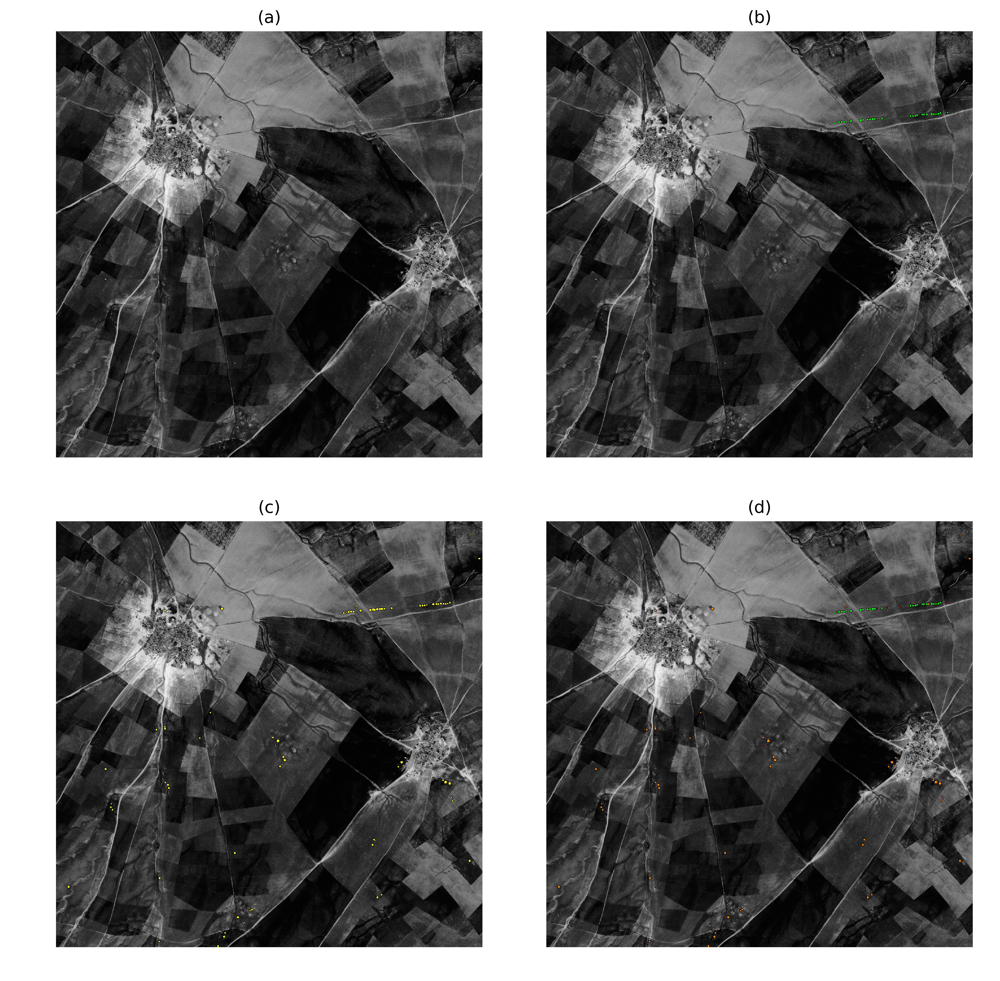

In [267]:
plt.figure(figsize=(10,10), dpi=400)
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.15, hspace=0.15)
plt.subplot(221)
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.title('(a)')
plt.axis('off')
#
plt.subplot(222)
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.imshow(label_nda_border, cmap=cmap_black)
plt.imshow(label_nda, alpha=1, cmap=cmap_ground_truth)
plt.title('(b)')
plt.axis('off')
#
plt.subplot(223)
plt.title('(c)')
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.imshow(pred_nda_border, cmap=cmap_black)
plt.imshow(pred_nda, cmap=cmap_pred)
plt.axis('off')
#
plt.subplot(224)
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.imshow(label_nda_border, cmap=cmap_black)
plt.imshow(tp_nda, cmap=cmap_ground_truth)
plt.imshow(fn_nda, cmap=cmap_red)
plt.imshow(fp_border_nda, cmap=cmap_black)
plt.imshow(fp_nda, cmap=cmap_orange)
plt.title('(d)')
plt.axis('off');
plt.savefig(os.path.join(output_folder, file_prefix + '_2x2.png'))

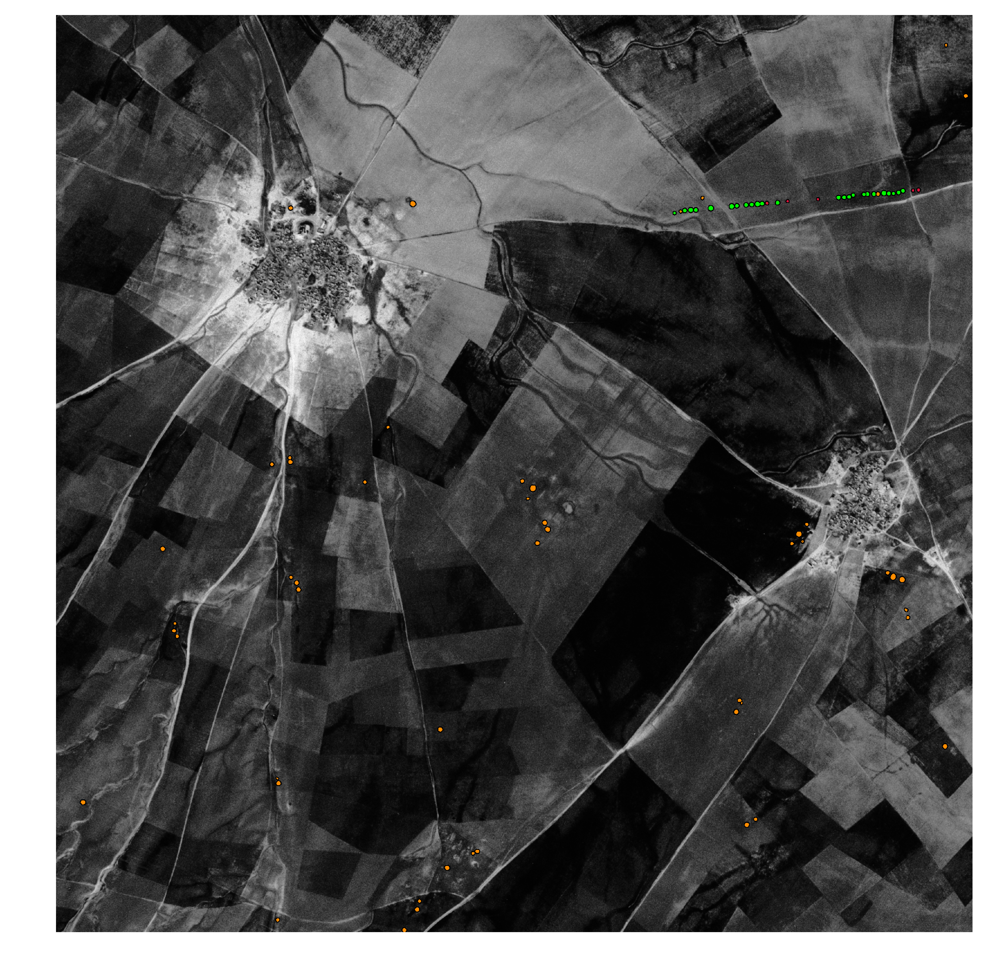

In [268]:
plt.figure(figsize=(10,10), dpi=400)
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.15, hspace=0.15)
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.01, hspace=0.1)
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.imshow(label_nda_border, cmap=cmap_black)
plt.imshow(tp_nda, cmap=cmap_ground_truth)
plt.imshow(fn_nda, cmap=cmap_red)
plt.imshow(fp_border_nda, cmap=cmap_black)
plt.imshow(fp_nda, cmap=cmap_orange)
plt.axis('off');
plt.savefig(os.path.join(output_folder, file_prefix + '_all.png'))

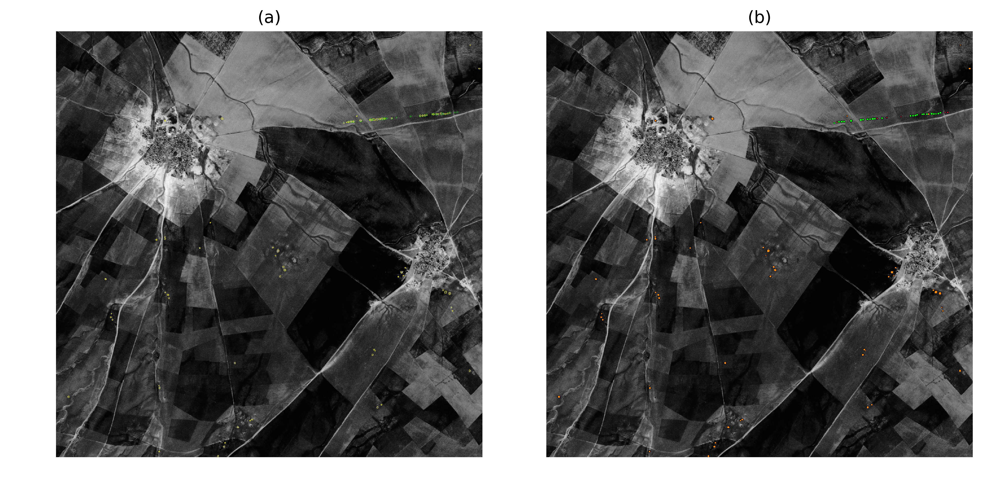

In [269]:
plt.figure(figsize=(10,5), dpi=400)
plt.subplots_adjust(left=0.05, bottom=0.05, right=0.95, top=0.95, wspace=0.15, hspace=0.15)

plt.subplot(121)
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.imshow(label_bnd_nda, cmap=cmap_ground_truth, alpha=0.7)
plt.imshow(pred_bnd_nda, cmap=cmap_pred,alpha=1)
plt.title('(a)')
plt.axis('off');

plt.subplot(122)
plt.imshow(image_nda, cmap=plt.cm.gray)
plt.imshow(label_nda_border, cmap=cmap_black)
plt.imshow(tp_nda, cmap=cmap_ground_truth)
plt.imshow(fn_nda, cmap=cmap_red)
plt.imshow(fp_border_nda, cmap=cmap_black)
plt.imshow(fp_nda, cmap=cmap_orange)
plt.title('(b)')
plt.axis('off');
plt.savefig(os.path.join(output_folder, file_prefix + '_side_by_side.png'))

In [270]:
def plot_confusion_matrix(tp,fn, fp, ax, cmap=plt.cm.gray_r, thresh=700):
    title = 'Confusion matrix'
    cm = np.array([[np.nan, fp],[fn, tp]])
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    # ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           title=title,
           ylabel='True class',
           xlabel='Predicted class')

    # Rotate the tick labels and set their alignment.
    # plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
    #         rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    # fmt = '.2f' if normalize else 'd'
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            if i== 0 and j == 0:
                text_value = 'N/A'
            else: 
                text_value = '{0:d}'.format(int(cm[i, j]))
            ax.text(j, i, text_value,
                    # format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    return ax

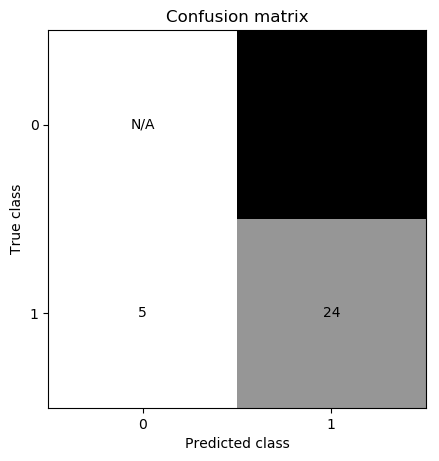

In [271]:
fig, ax = plt.subplots(1, 1, dpi=100, figsize=(5, 5))
plot_confusion_matrix(tp_count, fn_count, fp_count, ax);
plt.savefig(os.path.join(output_folder, file_prefix + '_cm.png'))

In [272]:
tp_count_total += tp_count
fp_count_total += fp_count
fn_count_total += fn_count
patch_count += 1

In [273]:
d.append(OrderedDict({"patch": labels_dropdown.value, "tp_count": tp_count, "fp_count": fp_count, "fn_count":fn_count, 
                 "precision": precision, "recall": recall, "f1": f1}))

In [274]:
df = pd.DataFrame(d)
df

,patch,tp_count,fp_count,fn_count,precision,recall,f1
0,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,744,366,382,0.670270,0.660746,0.665474
1,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,628,310,136,0.669510,0.821990,0.737955
2,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,54,51,29,0.514286,0.650602,0.574468
3,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,11,92,12,0.106796,0.478261,0.174603
4,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,39,41,33,0.487500,0.541667,0.513158
5,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,115,174,94,0.397924,0.550239,0.461847
6,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,1001,309,177,0.764122,0.849745,0.804662
7,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,201,261,43,0.435065,0.823770,0.569405
8,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,15,58,9,0.205479,0.625000,0.309278
9,/home/mehrtash/dropbox/qanat_v2/intermediate/t...,31,45,69,0.407895,0.310000,0.352273


# Stop here

In [275]:
print(patch_count)

11


## folowing line after all of calculations

In [276]:
precision = (tp_count_total)/(tp_count_total + fp_count_total)
recall = tp_count_total/(tp_count_total + fn_count_total)
f1 = 2*tp_count_total/ (2*tp_count_total + fp_count_total +fn_count_total)

In [277]:
d.append(OrderedDict({"patch": "all", "tp_count": tp_count_total, "fp_count": fp_count_total, "fn_count":fn_count_total, 
                 "precision": precision, "recall": recall, "f1": f1}))

In [278]:
df = pd.DataFrame(d)
df.to_csv(os.path.join(output_folder, 'stats.csv'), index=False)

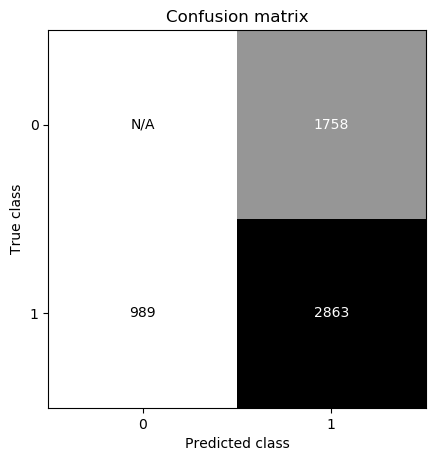

In [279]:
fig, ax = plt.subplots(1, 1, dpi=100, figsize=(5, 5))
plot_confusion_matrix(tp_count_total, fn_count_total, fp_count_total, ax, thresh=1500);
plt.savefig(os.path.join(output_folder, 'all_cm.png'))